# CenterNet Baseline ++

Changes from baseline:
* Larger input size (2048x768)
* Longer training (50 epochs)
* use focal loss
* use gaussian masks and regression targets
* Normalize input image
* Change model scale to 4
* Change distance threshold to 4
* Pool output by 3x3 pooling

In [1]:
TRAIN = False
BATCH_SIZE = 1

In [2]:
IMG_WIDTH = 2048
IMG_HEIGHT = 768
MODEL_SCALE = 4
MARGIN = 4

In [3]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import cv2
from tqdm import tqdm_notebook as tqdm
import matplotlib.pyplot as plt
import seaborn as sns
from functools import reduce
import os
from scipy.optimize import minimize
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.utils.data import Dataset, DataLoader
from torchvision import models
from torchvision import transforms, utils

PATH = './'
os.listdir(PATH)

['centernet-baseline-v2.ipynb',
 'predictions_01.csv',
 'train-psuedo.csv',
 'predictions.csv',
 'train_mask_v2.zip',
 'line.py',
 'depth2.zip',
 'images',
 'nohup.out',
 'centernet-baseline-v3.ipynb',
 'test_mask.zip',
 'sample_submission.csv',
 'val',
 'kaggle-pku-autonomous-driving',
 'FPN_test.ipynb',
 'log_output_eval_res.csv',
 'depth',
 'pku-autonomous-driving.zip',
 'centernet-baseline.ipynb',
 'centernet-baseline-encode-z-rotate-res18.ipynb',
 'center-resnet.ipynb',
 'dla.py',
 'predictions045.csv',
 'centernet-baseline-encode-z-fewregr.ipynb',
 'predictions_-02.csv',
 'test_mask_image_v2',
 'centernet-baseline-encode-z-res.ipynb',
 'centernet-baseline-v13.ipynb',
 'train_psuedo',
 'depth_test.zip',
 'camera_intrinsic.txt',
 'mmdetection',
 'data_aug.py',
 'distance',
 'utils',
 'old',
 'log_output_eval.csv',
 '.test_mask_image_v2',
 'predictions_0.csv',
 'depth_test',
 'model.pth',
 'annotations',
 'log_output_eval2-encz.csv',
 'train_mask_image',
 'test.csv',
 'log',
 'cente

# Load data

In [4]:
train = pd.read_csv(PATH + 'train.csv')
test = pd.read_csv(PATH + 'sample_submission.csv')

# From camera.zip
camera_matrix = np.array([[2304.5479, 0,  1686.2379],
                          [0, 2305.8757, 1354.9849],
                          [0, 0, 1]], dtype=np.float32)
camera_matrix_inv = np.linalg.inv(camera_matrix)

In [5]:
def imread(path, fast_mode=False):
    img = cv2.imread(path)
    if not fast_mode and img is not None and len(img.shape) == 3:
        img = np.array(img[:, :, ::-1])
    return img

In [6]:
def str2coords(s, names=['id', 'yaw', 'pitch', 'roll', 'x', 'y', 'z']):
    '''
    Input:
        s: PredictionString (e.g. from train dataframe)
        names: array of what to extract from the string
    Output:
        list of dicts with keys from `names`
    '''
    coords = []
    for l in np.array(s.split()).reshape([-1, 7]):
        coords.append(dict(zip(names, l.astype('float'))))
        if 'id' in coords[-1]:
            coords[-1]['id'] = int(coords[-1]['id'])
    return coords

# 2D Visualization

In [7]:
def get_img_coords(s):
    '''
    Input is a PredictionString (e.g. from train dataframe)
    Output is two arrays:
        xs: x coordinates in the image (row)
        ys: y coordinates in the image (column)
    '''
    coords = str2coords(s)
    xs = [c['x'] for c in coords]
    ys = [c['y'] for c in coords]
    zs = [c['z'] for c in coords]
    P = np.array(list(zip(xs, ys, zs))).T
    img_p = np.dot(camera_matrix, P).T
    img_p[:, 0] /= img_p[:, 2]
    img_p[:, 1] /= img_p[:, 2]
    img_xs = img_p[:, 0]
    img_ys = img_p[:, 1]
    img_zs = img_p[:, 2] # z = Distance from the camera
    return img_xs, img_ys


# 3D Visualization
Used code from https://www.kaggle.com/zstusnoopy/visualize-the-location-and-3d-bounding-box-of-car, but made it one function

In [8]:
from math import sin, cos

# convert euler angle to rotation matrix
def euler_to_Rot(yaw, pitch, roll):
    Y = np.array([[cos(yaw), 0, sin(yaw)],
                  [0, 1, 0],
                  [-sin(yaw), 0, cos(yaw)]])
    P = np.array([[1, 0, 0],
                  [0, cos(pitch), -sin(pitch)],
                  [0, sin(pitch), cos(pitch)]])
    R = np.array([[cos(roll), -sin(roll), 0],
                  [sin(roll), cos(roll), 0],
                  [0, 0, 1]])
    return np.dot(Y, np.dot(P, R))

In [9]:
def draw_line(image, points):
    color = (255, 0, 0)
    try:
        cv2.line(image, tuple(points[0][:2]), tuple(points[3][:2]), color, 16)
        cv2.line(image, tuple(points[0][:2]), tuple(points[1][:2]), color, 16)
        cv2.line(image, tuple(points[1][:2]), tuple(points[2][:2]), color, 16)
        cv2.line(image, tuple(points[2][:2]), tuple(points[3][:2]), color, 16)
    except:
        pass
    return image


def draw_points(image, points):
    try:
        for (p_x, p_y, p_z) in points:
            cv2.circle(image, (p_x, p_y), int(1000 / p_z), (0, 255, 0), -1)
    #         if p_x > image.shape[1] or p_y > image.shape[0]:
    #             print('Point', p_x, p_y, 'is out of image with shape', image.shape)
        return image
    except:
        pass

In [22]:
def visualize(img, coords):
    # You will also need functions from the previous cells
    x_l = 1.02
    y_l = 0.80
    z_l = 2.31
    
    img = img.copy()
    for point in coords:
        # Get values
        x, y, z = point['x'], point['y'], point['z']
        yaw, pitch, roll = -point['pitch'], -point['yaw'], -point['roll']
        # Math
        Rt = np.eye(4)
        t = np.array([x, y, z])
        Rt[:3, 3] = t
        Rt[:3, :3] = euler_to_Rot(yaw, pitch, roll).T
        Rt = Rt[:3, :]
        P = np.array([[x_l, -y_l, -z_l, 1],
                      [x_l, -y_l, z_l, 1],
                      [-x_l, -y_l, z_l, 1],
                      [-x_l, -y_l, -z_l, 1],
                      [0, 0, 0, 1]]).T
        img_cor_points = np.dot(camera_matrix, np.dot(Rt, P))
        img_cor_points = img_cor_points.T
        img_cor_points[:, 0] /= img_cor_points[:, 2]
        img_cor_points[:, 1] /= img_cor_points[:, 2]
        img_cor_points = img_cor_points.astype(int)
        # Drawing
        img = draw_line(img, img_cor_points)
        img = draw_points(img, img_cor_points[-1:])
    
    return img

# Image preprocessing

In [23]:


def sigmoid(data):
    return 1 / (1 + np.exp(-data))

def invsigmoid(data):
    return np.log(data / (1 -data))

def rotate(x, angle):
    x = x + angle
    x = x - (x + np.pi) // (2 * np.pi) * 2 * np.pi
    return x

def _regr_preprocess(regr_dict):
    for name in ['x', 'y', 'z']:
        regr_dict[name] = regr_dict[name] / 100
    regr_dict["z"] = 1/(sigmoid(regr_dict["z"]))-1
    regr_dict['roll'] = rotate(regr_dict['roll'], np.pi)
    regr_dict['pitch_sin'] = sin(regr_dict['pitch'])
    regr_dict['pitch_cos'] = cos(regr_dict['pitch'])
    regr_dict.pop('pitch')
    regr_dict.pop('id')
    return regr_dict

def _regr_back(regr_dict):
    regr_dict["z"] = invsigmoid(1/(regr_dict["z"]+1))
    for name in ['x', 'y', 'z']:
        regr_dict[name] = regr_dict[name] * 100
    regr_dict['roll'] = rotate(regr_dict['roll'], -np.pi)
    
    pitch_sin = regr_dict['pitch_sin'] / np.sqrt(regr_dict['pitch_sin']**2 + regr_dict['pitch_cos']**2)
    pitch_cos = regr_dict['pitch_cos'] / np.sqrt(regr_dict['pitch_sin']**2 + regr_dict['pitch_cos']**2)
    regr_dict['pitch'] = np.arccos(pitch_cos) * np.sign(pitch_sin)
    return regr_dict

def preprocess_image(img, flip=False):
    img = img[img.shape[0] // 2:]
    bg = np.ones_like(img) * img.mean(1, keepdims=True).astype(img.dtype)
    bg = bg[:, :img.shape[1] // MARGIN]
    img = np.concatenate([bg, img, bg], 1)
    img = cv2.resize(img, (IMG_WIDTH, IMG_HEIGHT))
    
    if flip:
        img = img[:,::-1]
    return (img / 255).astype('float32')

def preprocess_bg(img, flip=False):
    img = img[img.shape[0] // 2:]
    bg = np.zeros_like(img) * img.mean(1, keepdims=True).astype(img.dtype)
    bg = bg[:, :img.shape[1] // 8]
    img = np.concatenate([bg, img, bg], 1)
    img = cv2.resize(img, (IMG_WIDTH, IMG_HEIGHT))
    
    if flip:
        img = img[:,::-1]
    return (img).astype('float32')

# from centernet repo
def draw_msra_gaussian(heatmap, center, sigma=1):
  tmp_size = sigma * 3
  mu_x = int(center[0] + 0.5)
  mu_y = int(center[1] + 0.5)
  w, h = heatmap.shape[0], heatmap.shape[1]
  ul = [int(mu_x - tmp_size), int(mu_y - tmp_size)]
  br = [int(mu_x + tmp_size + 1), int(mu_y + tmp_size + 1)]
  if ul[0] >= h or ul[1] >= w or br[0] < 0 or br[1] < 0:
    return heatmap
  size = 2 * tmp_size + 1
  x = np.arange(0, size, 1, np.float32)
  y = x[:, np.newaxis]
  x0 = y0 = size // 2
  g = np.exp(- ((x - x0) ** 2 + (y - y0) ** 2) / (2 * sigma ** 2))
  g_x = max(0, -ul[0]), min(br[0], h) - ul[0]
  g_y = max(0, -ul[1]), min(br[1], w) - ul[1]
  img_x = max(0, ul[0]), min(br[0], h)
  img_y = max(0, ul[1]), min(br[1], w)
  heatmap[img_y[0]:img_y[1], img_x[0]:img_x[1]] = np.maximum(
    heatmap[img_y[0]:img_y[1], img_x[0]:img_x[1]],
    g[g_y[0]:g_y[1], g_x[0]:g_x[1]])
  return heatmap

def draw_dense_reg(regmap, heatmap, center, value, radius=1, is_offset=False):
  diameter = 2 * radius + 1
  gaussian = gaussian2D((diameter, diameter), sigma= diameter/6)
  value = np.array(value, dtype=np.float32).reshape(-1, 1, 1)
  dim = value.shape[0]
  reg = np.ones((dim, diameter*2+1, diameter*2+1), dtype=np.float32) * value
  if is_offset and dim == 2:
    delta = np.arange(diameter*2+1) - radius
    reg[0] = reg[0] - delta.reshape(1, -1)
    reg[1] = reg[1] - delta.reshape(-1, 1)
  
  x, y = int(center[0]), int(center[1])

  height, width = heatmap.shape[0:2]
    
  left, right = min(x, radius), min(width - x, radius + 1)
  top, bottom = min(y, radius), min(height - y, radius + 1)

  masked_heatmap = heatmap[y - top:y + bottom, x - left:x + right]
  masked_regmap = regmap[:, y - top:y + bottom, x - left:x + right]
  masked_gaussian = gaussian[radius - top:radius + bottom,
                             radius - left:radius + right]
  masked_reg = reg[:, radius - top:radius + bottom,
                      radius - left:radius + right]
  if min(masked_gaussian.shape) > 0 and min(masked_heatmap.shape) > 0: # TODO debug
    idx = (masked_gaussian >= masked_heatmap).reshape(
      1, masked_gaussian.shape[0], masked_gaussian.shape[1])
    masked_regmap = (1-idx) * masked_regmap + idx * masked_reg
  regmap[:, y - top:y + bottom, x - left:x + right] = masked_regmap
  return regmap

def gaussian2D(shape, sigma=1):
    m, n = [(ss - 1.) / 2. for ss in shape]
    y, x = np.ogrid[-m:m+1,-n:n+1]

    h = np.exp(-(x * x + y * y) / (2 * sigma * sigma))
    h[h < np.finfo(h.dtype).eps * h.max()] = 0
    return h

# modify for this competition
def get_mask_and_regr(img, labels, flip=False, coord=False):
    mask = np.zeros([IMG_HEIGHT // MODEL_SCALE, IMG_WIDTH // MODEL_SCALE], dtype='float32')
    regr_names = ['x', 'y', 'z', 'yaw', 'pitch', 'roll']
    regr = np.zeros([IMG_HEIGHT // MODEL_SCALE, IMG_WIDTH // MODEL_SCALE, 7], dtype='float32')
    
    if not coord:
        coords = str2coords(labels)
        xs, ys = get_img_coords(labels)
    else:
        coords = labels
        xs, ys = labels2xs(coords)    
    
    regr = regr.transpose([2,0,1])
    
    for x, y, regr_dict in zip(xs, ys, coords):
        x, y = y, x
        x = (x - img.shape[0] // 2) * IMG_HEIGHT / (img.shape[0] // 2) / MODEL_SCALE
        x = np.round(x).astype('int')
        y = (y + img.shape[1] // MARGIN) * IMG_WIDTH / (img.shape[1] * 1.5) / MODEL_SCALE
        y = np.round(y).astype('int')
        if x >= 0 and x < IMG_HEIGHT // MODEL_SCALE and y >= 0 and y < IMG_WIDTH // MODEL_SCALE:
            mask = draw_msra_gaussian(mask, [y,x])
            #mask[x, y] = 1
            # radius = 30/regr_dict["z"]
            #print(regr_dict["z"])
            regr_dict = _regr_preprocess(regr_dict)
            regrs = [regr_dict[n] for n in sorted(regr_dict)]
            #print(radius)
            #radius = int(radius*2)
            #for i in range(7):
            regr = draw_dense_reg(regr, mask, [y,x], regrs, 3, True)
            #regr[x, y] = [regr_dict[n] for n in sorted(regr_dict)]
    regr = regr.transpose([1,2,0])
    
    # create mask in regr as well
    for i, r in enumerate(regr[0,0,:]):
        #print(regr.shape)
        regr[:,:,i] *= (mask > 0.1)
    
    if flip:
        mask = np.array(mask[:,::-1])
        regr = np.array(regr[:,::-1])
    return mask, regr

In [24]:
# Load a 3D model of a car
import json
#with open(PATH+'car_models_json/mazida-6-2015.json') as json_file:
#    data = json.load(json_file)
#vertices = np.array(data['vertices'])
#vertices[:, 1] = -vertices[:, 1]
#triangles = np.array(data['faces']) - 1

In [25]:
im_color = cv2.applyColorMap(np.arange(256).astype('uint8') , cv2.COLORMAP_HSV)[:,0,:]
CV_PI = np.pi

def rotateImage(img, alpha=0, beta=0, gamma=0):
    fx, dx = 2304.5479, 1686.2379
    fy, dy = 2305.8757, 1354.9849
    # get width and height for ease of use in matrices
    h, w = img.shape[:2]
    # Projection 2D -> 3D matrix
    A1 = np.array([[1/fx, 0, -dx/fx],
                   [0, 1/fx, -dy/fx],
                   [0, 0,    1],
                   [0, 0,    1]])
    
    # Rotation matrices around the X, Y, and Z axis
    RX = np.array([[1,          0,           0, 0],
             [0, cos(alpha), -sin(alpha), 0],
             [0, sin(alpha),  cos(alpha), 0],
             [0,          0,           0, 1]])
    
    RY = np.array([[cos(beta), 0, -sin(beta), 0],
              [0, 1,          0, 0],
              [sin(beta), 0,  cos(beta), 0],
              [0, 0,          0, 1]])
    RZ = np.array([[cos(gamma), -sin(gamma), 0, 0],
              [sin(gamma),  cos(gamma), 0, 0],
              [0,          0,           1, 0],
              [0,          0,           0, 1]])
    # Composed rotation matrix with (RX, RY, RZ)
    R = np.dot(RZ, np.dot(RX, RY))

    # 3D -> 2D matrix
    A2 = np.array([[fx, 0, dx, 0],
                   [0, fy, dy, 0],
                   [0, 0,   1, 0]])
    # Final transformation matrix
    trans = np.dot(A2,np.dot(R, A1))
    # Apply matrix transformation
    return cv2.warpPerspective(img, trans, (w,h), flags=cv2.INTER_LANCZOS4), trans, R

def draw_car(yaw, pitch, roll, x, y, z, overlay, color=(0,0,255)):
    yaw, pitch, roll = -pitch, -yaw, -roll
    Rt = np.eye(4)
    t = np.array([x, y, z])
    Rt[:3, 3] = t
    Rt[:3, :3] = euler_to_Rot(yaw, pitch, roll).T
    Rt = Rt[:3, :]
    P = np.ones((vertices.shape[0],vertices.shape[1]+1))
    P[:, :-1] = vertices
    P = P.T
    img_cor_points = np.dot(k, np.dot(Rt, P))
    img_cor_points = img_cor_points.T
    img_cor_points[:, 0] /= img_cor_points[:, 2]
    img_cor_points[:, 1] /= img_cor_points[:, 2]
    draw_obj(overlay, img_cor_points, triangles, color)
    return overlay

def draw_obj(image, vertices, triangles, color):
    for t in triangles:
        coord = np.array([vertices[t[0]][:2], vertices[t[1]][:2], vertices[t[2]][:2]], dtype=np.int32)
#         cv2.fillConvexPoly(image, coord, (0,0,255))
        cv2.polylines(image, np.int32([coord]), 1, color)

def euler_to_Rot(yaw, pitch, roll):
    Y = np.array([[cos(yaw), 0, sin(yaw)],
                  [0, 1, 0],
                  [-sin(yaw), 0, cos(yaw)]])
    P = np.array([[1, 0, 0],
                  [0, cos(pitch), -sin(pitch)],
                  [0, sin(pitch), cos(pitch)]])
    R = np.array([[cos(roll), -sin(roll), 0],
                  [sin(roll), cos(roll), 0],
                  [0, 0, 1]])
    return np.dot(Y, np.dot(P, R))

k = np.array([[2304.5479, 0,  1686.2379],
           [0, 2305.8757, 1354.9849],
           [0, 0, 1]], dtype=np.float32)

In [26]:
from scipy.spatial.transform import Rotation as R
def draw_rot(img, labels, alpha = 0, beta = 0, gamma = 0, mask=None, show=False):
    pred_string = labels
    items = pred_string.split(' ')
    items = np.array(items, dtype='float')
    model_types, yaws, pitches, rolls, xs, ys, zs = [items[i::7] for i in range(7)]

    alpha = alpha*CV_PI/180.
    beta = beta*CV_PI/180.
    gamma = gamma*CV_PI/180.

    dst, Mat,Rot = rotateImage(img, alpha, beta, gamma)
    mask, Mat,Rot = rotateImage(mask, alpha, beta, gamma)
    overlay = np.zeros_like(dst)

    for i, (yaw, pitch, roll, x, y, z) in enumerate(zip(yaws, pitches, rolls, xs, ys, zs)):

        x,y,z,_ = np.dot(Rot,[x, y, z, 1])

        r1 = R.from_euler('xyz', [-pitch, -yaw, -roll], degrees=False)
        r2 = R.from_euler('xyz', [beta, -alpha, -gamma], degrees=False)

        pitch2, yaw2, roll2 = (r2*r1).as_euler('xyz')*(-1)

        color = im_color[np.random.randint(256)].tolist()
        if show:
            overlay = draw_car(yaw2, pitch2, roll2, x, y, z, overlay, color)

        #print("yaw, pitch, roll, yaw2, pitch2, roll2", np.array([yaw, pitch, roll, yaw2, pitch2, roll2]))
        #print("xyz", np.array([x,y,z]))
        
        yaws[i] = yaw2
        pitches[i] = pitch2
        rolls[i] = roll2
        xs[i] = x
        ys[i] = y
        zs[i] = z
        #break
    if show:
        plt.figure(figsize=(20,20))
        plt.imshow((dst*(np.sum(overlay, axis=-1)[:,:,np.newaxis]==0)+overlay), interpolation='lanczos')
    
    return yaws, pitches, rolls, xs, ys, zs, dst, mask

In [27]:
def coords2str(coords, names=['yaw', 'pitch', 'roll', 'x', 'y', 'z', 'confidence']):
    s = []
    for c in coords:
        for n in names:
            s.append(str(c.get(n, 0)))
    return ' '.join(s)

def stuff2coords(yaws, pitches, rolls, xs, ys, zs):
    coords = []
    names=['yaw', 'pitch', 'roll', 'x', 'y', 'z', 'id']
    for i, (yaw, pitch, roll, x, y, z) in enumerate(zip(yaws, pitches, rolls, xs, ys, zs)):
        coords.append(dict(zip(names, [yaw,pitch,roll,x,y,z,1])))
    return coords

def str2coords(s, names=['id', 'yaw', 'pitch', 'roll', 'x', 'y', 'z']):
    '''
    Input:
        s: PredictionString (e.g. from train dataframe)
        names: array of what to extract from the string
    Output:
        list of dicts with keys from `names`
    '''
    coords = []
    for l in np.array(s.split()).reshape([-1, 7]):
        coords.append(dict(zip(names, l.astype('float'))))
        if 'id' in coords[-1]:
            coords[-1]['id'] = int(coords[-1]['id'])
    return coords

def labels2xs(coords):
    xs = [c['x'] for c in coords]
    ys = [c['y'] for c in coords]
    zs = [c['z'] for c in coords]
    P = np.array(list(zip(xs, ys, zs))).T
    img_p = np.dot(camera_matrix, P).T
    img_p[:, 0] /= img_p[:, 2]
    img_p[:, 1] /= img_p[:, 2]
    img_xs = img_p[:, 0]
    img_ys = img_p[:, 1]
    img_zs = img_p[:, 2] # z = Distance from the camera
    return img_xs, img_ys

def get_img_coords(s):
    '''
    Input is a PredictionString (e.g. from train dataframe)
    Output is two arrays:
        xs: x coordinates in the image
        ys: y coordinates in the image
    '''
    coords = str2coords(s)
    xs = [c['x'] for c in coords]
    ys = [c['y'] for c in coords]
    zs = [c['z'] for c in coords]
    P = np.array(list(zip(xs, ys, zs))).T
    img_p = np.dot(camera_matrix, P).T
    img_p[:, 0] /= img_p[:, 2]
    img_p[:, 1] /= img_p[:, 2]
    img_xs = img_p[:, 0]
    img_ys = img_p[:, 1]
    img_zs = img_p[:, 2] # z = Distance from the camera
    return img_xs, img_ys

In [28]:
img0 = imread(PATH + 'train_images/' + train['ImageId'][0] + '.jpg')
IMG_SHAPE = img0.shape

# augument
yaws, pitches, rolls, xs, ys, zs, dst = draw_rot(img0, train['PredictionString'][0], alpha=1,beta=10)
coords = stuff2coords(yaws, pitches, rolls, xs, ys, zs)

img = preprocess_image(dst)

print(coords)
mask, regr, mask2 = get_mask_and_regr(img0, coords, coord=True)

print('img.shape', img.shape, 'std:', np.std(img))
print('mask.shape', mask.shape, 'std:', np.std(mask))
print('regr.shape', regr.shape, 'std:', np.std(regr))

plt.figure(figsize=(16,16))
plt.title('Processed image')
plt.imshow(img)
plt.show()

plt.figure(figsize=(16,16))
plt.title('Detection Mask')
plt.imshow(mask)
plt.show()

plt.figure(figsize=(16,16))
plt.title('Detection Mask')
plt.imshow(mask2)
plt.show()


plt.figure(figsize=(16,16))
plt.title('Yaw values')
plt.imshow(regr[:,:,-2])
plt.show()

AttributeError: 'NoneType' object has no attribute 'shape'

In [29]:
np.sum(mask)

31.398926

In [30]:
np.sum(mask==1)

5

# PyTorch Dataset

In [31]:
class CarDataset(Dataset):
    """Car dataset."""

    def __init__(self, dataframe, root_dir, mask_root_dir=None, training=True, transform=None, data_aug=False):
        self.df = dataframe
        self.root_dir = root_dir
        self.transform = transform
        self.training = training
        self.data_aug = data_aug
        self.mask_root_dir = mask_root_dir  # ignore mask
        if data_aug:
            self.data_aug_func = train_aug_trasforms = alb.Compose([
                alb.RandomBrightnessContrast(0.05, 0.05, p=0.2),
                alb.GaussNoise(var_limit=(10.0, 50.0), p=0.1),
            ], p=1)
            
    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        
        # Get image name
        idx2 = idx
        idx, labels = self.df.values[idx]
        img_name = self.root_dir.format(idx)
        img0 = imread(img_name, True)
        ign_mask = cv2.imread(self.mask_root_dir.format(idx), cv2.IMREAD_GRAYSCALE)
        if ign_mask is None:  # some pics has NO MASK
            ign_mask = np.zeros(IMG_SHAPE[0:2], dtype='float32')
        if self.data_aug:
            img0 = self.data_aug_func(image=img0)["image"]
        
        # Augmentation
        flip = False
        alpha = 0
        beta = 0
        mask = 0
        while np.sum(mask) == 0:
            if self.training:
                if np.random.rand() < 0.3:
                    flip = True
            if self.training:
                if np.random.rand() < 0.5:
                    alpha = (np.random.rand()-0.5)*5
                    beta = (np.random.rand()-0.5)*30

            # augument
            
            yaws, pitches, rolls, xs, ys, zs, dst, ign_mask = draw_rot(img0, labels, alpha=alpha, beta=beta, mask=ign_mask)
            coords = stuff2coords(yaws, pitches, rolls, xs, ys, zs)
            img = preprocess_image(dst, flip=flip)
            ign_mask = preprocess_image(ign_mask, flip=flip)[::4,::4]
            img = np.rollaxis(img, 2, 0)
            
            # normalize image
            norm = True
            if norm:
                mean = np.array([[0.485, 0.456, 0.406]]).T
                std =  np.array([[0.229, 0.224, 0.225]]).T
                img[0] -= mean[0]
                img[0] /= std[0]
                img[1] -= mean[1]
                img[1] /= std[1]
                img[2] -= mean[2]
                img[2] /= std[2]

            # Get mask and regression maps
            mask, regr = get_mask_and_regr(dst, coords, coord=True, flip=flip)
            regr = np.rollaxis(regr, 2, 0)
            #mask *= (ign_mask==0)
        
        return [img, mask, regr, ign_mask]

In [32]:
train_images_dir = PATH + 'train_images/{}.jpg'
test_images_dir = PATH + 'test_images/{}.jpg'
train_masks_dir = PATH + 'train_masks/{}.jpg'
test_masks_dir = PATH + 'test_masks/{}.jpg'

df_train, df_dev = train_test_split(train, test_size=0.2, random_state=42)
df_test = test

# Create dataset objects
train_dataset = CarDataset(df_train, train_images_dir, train_masks_dir, training=True)
dev_dataset = CarDataset(df_dev, train_images_dir, train_masks_dir, training=False)
test_dataset = CarDataset(df_test, test_images_dir, test_masks_dir, training=False)

Show some generated examples

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


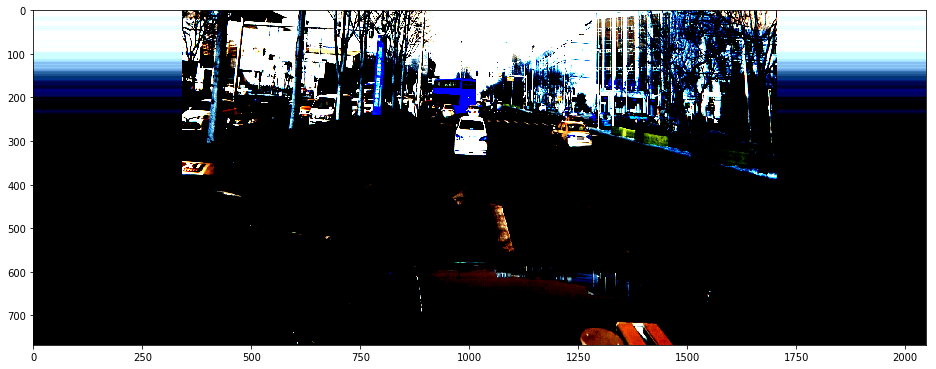

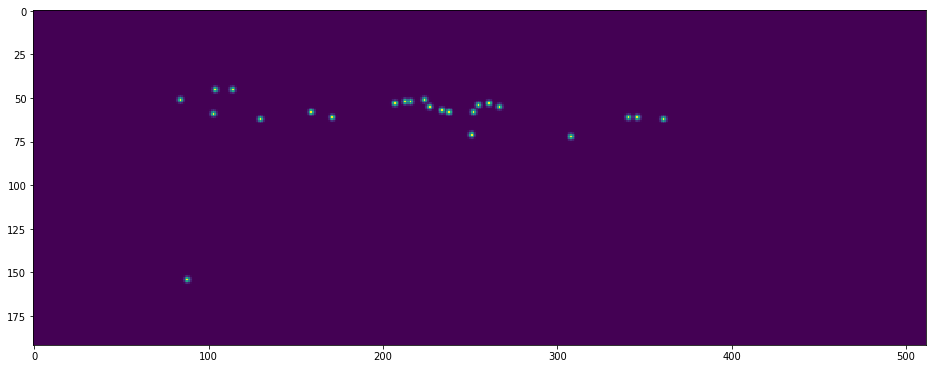

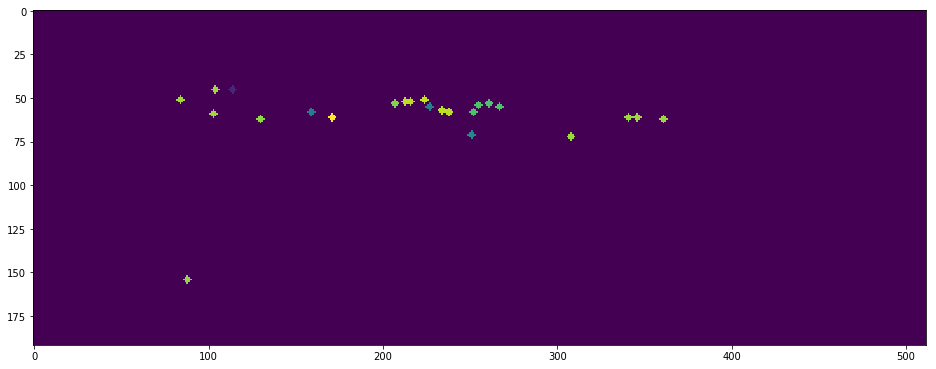

In [33]:
img, mask, regr, mask2 = train_dataset[0]

plt.figure(figsize=(16,16))
plt.imshow(np.rollaxis(img, 0, 3))
plt.show()

plt.figure(figsize=(16,16))
plt.imshow(mask)
plt.show()

plt.figure(figsize=(16,16))
plt.imshow(regr[-2])
plt.show()

In [34]:
# Create data generators - they will produce batches
train_loader = DataLoader(dataset=train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=8)
dev_loader = DataLoader(dataset=dev_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=8)
test_loader = DataLoader(dataset=test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=8)

# PyTorch Model

In [35]:
class double_conv(nn.Module):
    '''(conv => BN => ReLU) * 2'''
    def __init__(self, in_ch, out_ch):
        super(double_conv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        x = self.conv(x)
        return x

class up(nn.Module):
    def __init__(self, in_ch, out_ch, bilinear=True):
        super(up, self).__init__()

        #  would be a nice idea if the upsampling could be learned too,
        #  but my machine do not have enough memory to handle all those weights
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch//2, in_ch//2, 2, stride=2)

        self.conv = double_conv(in_ch, out_ch)

    def forward(self, x1, x2=None):
        x1 = self.up(x1)
        
        # input is CHW
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = F.pad(x1, (diffX // 2, diffX - diffX//2,
                        diffY // 2, diffY - diffY//2))
        
        # for padding issues, see 
        # https://github.com/HaiyongJiang/U-Net-Pytorch-Unstructured-Buggy/commit/0e854509c2cea854e247a9c615f175f76fbb2e3a
        # https://github.com/xiaopeng-liao/Pytorch-UNet/commit/8ebac70e633bac59fc22bb5195e513d5832fb3bd
        
        if x2 is not None:
            x = torch.cat([x2, x1], dim=1)
        else:
            x = x1
        x = self.conv(x)
        return x

def get_mesh(batch_size, shape_x, shape_y):
    mg_x, mg_y = np.meshgrid(np.linspace(0, 1, shape_y), np.linspace(0, 1, shape_x))
    mg_x = np.tile(mg_x[None, None, :, :], [batch_size, 1, 1, 1]).astype('float32')
    mg_y = np.tile(mg_y[None, None, :, :], [batch_size, 1, 1, 1]).astype('float32')
    mesh = torch.cat([torch.tensor(mg_x).to(device), torch.tensor(mg_y).to(device)], 1)
    return mesh

In [36]:
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.model_zoo as model_zoo


model_urls = {
    'resnet18': 'https://download.pytorch.org/models/resnet18-5c106cde.pth',
    'resnet34': 'https://download.pytorch.org/models/resnet34-333f7ec4.pth',
    'resnet50': 'https://download.pytorch.org/models/resnet50-19c8e357.pth',
    'resnet101': 'https://download.pytorch.org/models/resnet101-5d3b4d8f.pth',
    'resnet152': 'https://download.pytorch.org/models/resnet152-b121ed2d.pth',
}


def conv3x3(in_planes, out_planes, stride=1):
    """3x3 convolution with padding"""
    return nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride,
                     padding=1, bias=False)


def conv1x1(in_planes, out_planes, stride=1):
    """1x1 convolution"""
    return nn.Conv2d(in_planes, out_planes, kernel_size=1, stride=stride, bias=False)


class BasicBlock(nn.Module):
    expansion = 1

    def __init__(self, inplanes, planes, stride=1):
        super(BasicBlock, self).__init__()

        self.conv1 = conv3x3(inplanes, planes, stride)
        self.bn1 = nn.GroupNorm(16, planes)

        self.conv2 = conv3x3(planes, planes)
        self.bn2 = nn.GroupNorm(16, planes)

        if stride != 1 or inplanes != planes:
            self.downsample = nn.Sequential(
                conv1x1(inplanes, planes, stride), nn.GroupNorm(16, planes))
        else:
            self.downsample = None


    def forward(self, x):
        identity = x

        out = F.relu(self.bn1(self.conv1(x)), inplace=True)
        out = self.bn2(self.conv2(out))

        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = F.relu(out, inplace=True)

        return out


class Bottleneck(nn.Module):
    expansion = 4

    def __init__(self, inplanes, planes, stride=1):
        super(Bottleneck, self).__init__()
        self.conv1 = conv1x1(inplanes, planes)
        self.bn1 = nn.GroupNorm(16, planes)
        self.conv2 = conv3x3(planes, planes, stride)
        self.bn2 = nn.GroupNorm(16, planes)
        self.conv3 = conv1x1(planes, planes * self.expansion)
        self.bn3 = nn.GroupNorm(16, planes * self.expansion)

        if stride != 1 or inplanes != planes * self.expansion:
            self.downsample = nn.Sequential(
                conv1x1(inplanes, planes * self.expansion, stride), 
                nn.GroupNorm(16, planes * self.expansion))
        else:
            self.downsample = None

    def forward(self, x):
        identity = x

        out = F.relu(self.bn1(self.conv1(x)), inplace=True)
        out = F.relu(self.bn2(self.conv2(out)), inplace=True)
        out = self.bn3(self.conv3(out))
 
        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = F.relu(out)

        return out


class ResNetFeatures(nn.Module):

    def __init__(self, block, layers, num_classes=1000, zero_init_residual=False, input_channels=3):
        super(ResNetFeatures, self).__init__()
        self.inplanes = 64
        self.conv1 = nn.Conv2d(input_channels, 64, kernel_size=7, stride=2, padding=3,
                               bias=False)
        self.bn1 = nn.GroupNorm(16, 64)

        self.layer1 = self._make_layer(block, 64, layers[0])
        self.layer2 = self._make_layer(block, 128, layers[1], stride=2)
        self.layer3 = self._make_layer(block, 256, layers[2], stride=2)
        self.layer4 = self._make_layer(block, 512, layers[3], stride=2)


        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

        # Zero-initialize the last BN in each residual branch,
        # so that the residual branch starts with zeros, and each residual block behaves like an identity.
        # This improves the model by 0.2~0.3% according to https://arxiv.org/abs/1706.02677
        if zero_init_residual:
            for m in self.modules():
                if isinstance(m, Bottleneck):
                    nn.init.constant_(m.bn3.weight, 0)
                elif isinstance(m, BasicBlock):
                    nn.init.constant_(m.bn2.weight, 0)

    def _make_layer(self, block, planes, blocks, stride=1):

        layers = []
        layers.append(block(self.inplanes, planes, stride))
        self.inplanes = planes * block.expansion
        for _ in range(1, blocks):
            layers.append(block(self.inplanes, planes))

        return nn.Sequential(*layers)


    def forward(self, x):
        conv1 = F.relu(self.bn1(self.conv1(x)), inplace=True)
        conv1 = F.max_pool2d(conv1, 3, stride=2, padding=1)

        feats4 = self.layer1(conv1)
        feats8 = self.layer2(feats4)
        feats16 = self.layer3(feats8)
        feats32 = self.layer4(feats16)

        return feats8, feats16, feats32



def resnet18(pretrained=False, **kwargs):
    """Constructs a ResNet-18 model.
    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
    """
    model = ResNetFeatures(BasicBlock, [2, 2, 2, 2], **kwargs)
    if pretrained:
        _load_pretrained(model, model_zoo.load_url(model_urls['resnet18']))
    return model



def resnet34(pretrained=False, **kwargs):
    """Constructs a ResNet-34 model.
    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
    """
    model = ResNetFeatures(BasicBlock, [3, 4, 6, 3], **kwargs)
    if pretrained:
        _load_pretrained(model, model_zoo.load_url(model_urls['resnet34']))
    return model


def _load_pretrained(model, pretrained):
    model_dict = model.state_dict()
    pretrained = {k : v for k, v in pretrained.items() if k in model_dict}
    model_dict.update(pretrained)
    model.load_state_dict(model_dict)

In [37]:
class MyUNet(nn.Module):
    '''Mixture of previous classes'''
    def __init__(self, n_classes):
        super(MyUNet, self).__init__()
        self.base_model = resnet18(pretrained=False, input_channels=5)
        
        self.conv0 = double_conv(5, 64)
        self.conv1 = double_conv(64, 128)
        self.conv2 = double_conv(128, 512)
        self.conv3 = double_conv(512, 1024)
        
        self.mp = nn.MaxPool2d(2)
        
        self.up1 = up(1538, 512)
        self.up2 = up(512 + 512, 256)
        self.up3 = up(384, 256)
        self.outc = nn.Conv2d(256, n_classes, 1)

    def forward(self, x):
        batch_size = x.shape[0]
        mesh1 = get_mesh(batch_size, x.shape[2], x.shape[3])
        x0 = torch.cat([x, mesh1], 1)
        x1 = self.mp(self.conv0(x0))
        x2 = self.mp(self.conv1(x1))
        x3 = self.mp(self.conv2(x2))
        x4 = self.mp(self.conv3(x3))
        
        #x_center = x0[:, :, :, IMG_WIDTH // 8: -IMG_WIDTH // 8]
        #print(x_center.size())
        _, _, feats = self.base_model(x0)
        #bg = torch.zeros([feats.shape[0], feats.shape[1], feats.shape[2], feats.shape[3] // 8]).to(device)
        #feats = torch.cat([bg, feats, bg], 3)
        
        # Add positional info
        mesh2 = get_mesh(batch_size, feats.shape[2], feats.shape[3])
        feats = torch.cat([feats, mesh2], 1)
        
        x = self.up1(feats, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.outc(x)
        return x

In [38]:
# Gets the GPU if there is one, otherwise the cpu
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

n_epochs = 30

model = MyUNet(8).to(device)
optimizer = optim.Adam(model.parameters(), lr=0.0001)
exp_lr_scheduler = lr_scheduler.StepLR(optimizer, step_size=max(n_epochs, 10) * len(train_loader) // 3 *2, gamma=0.1)

cuda


In [39]:
# check inference
input = torch.rand((1,3,512,2048))
model(input.to(device)).size()

torch.Size([1, 8, 128, 512])

Looks great! Now to training.

# Training

In [40]:
# focal loss
def neg_loss(pred, gt):
  ''' Modified focal loss. Exactly the same as CornerNet.
      Runs faster and costs a little bit more memory
    Arguments:
      pred (batch x c x h x w)
      gt_regr (batch x c x h x w)
  '''
  pred = pred.unsqueeze(1).float()
  gt = gt.unsqueeze(1).float()

  pos_inds = gt.eq(1).float()
  neg_inds = gt.lt(1).float()
  neg_weights = torch.pow(1 - gt, 4)

  loss = 0

  pos_loss = torch.log(pred + 1e-12) * torch.pow(1 - pred, 3) * pos_inds
  neg_loss = torch.log(1 - pred + 1e-12) * torch.pow(pred, 3) * neg_weights * neg_inds

  num_pos  = pos_inds.float().sum()
  pos_loss = pos_loss.sum()
  neg_loss = neg_loss.sum()

  if num_pos == 0:
    loss = loss - neg_loss
  else:
    loss = loss - (pos_loss + neg_loss) / num_pos
  return loss

In [52]:
def criterion(prediction, mask, regr, weight=0.4, size_average=True):
    # Binary mask loss
    pred_mask = torch.sigmoid(prediction[:, 0])
    mask_loss = neg_loss(pred_mask, mask)
    
    sum=np.sum(mask.cpu().numpy()==1)
    
    # Regression L1 loss
    pred_regr = prediction[:, 1:]
    regr_loss = (torch.abs(pred_regr - regr).sum(1) * mask).sum(1).sum(1) / mask.sum(1).sum(1)
    regr_loss = regr_loss.mean(0)
  
    # Sum
    loss = mask_loss +regr_loss
    if not size_average:
        loss *= prediction.shape[0]
    return loss ,mask_loss , regr_loss

In [42]:
def train_model(epoch, history=None):
    model.train()
    t = tqdm(train_loader)
    maskloss_acc = []
    regrloss_acc = []
    
    # train loops
    ####################################################################################
    for batch_idx, (img_batch, mask_batch, regr_batch, mask2) in enumerate(t):
        img_batch = img_batch.to(device)
        mask_batch = mask_batch.to(device)
        regr_batch = regr_batch.to(device)
        mask2 = mask2.to(device)
        
        optimizer.zero_grad()
        output = model(img_batch)
        loss, mask_loss, regr_loss = criterion(output, mask_batch, regr_batch, mask2)
        if history is not None:
            history.loc[epoch + batch_idx / len(train_loader), 'train_loss'] = loss.data.cpu().numpy()
        maskloss_acc.append(mask_loss.data.cpu().numpy())
        regrloss_acc.append(regr_loss.data.cpu().numpy())
        loss.backward()
        
        t.set_description(f'train_loss (l={loss:.3f})(m={mask_loss:.2f}) (r={regr_loss:.4f}')
        
        optimizer.step()
        
        exp_lr_scheduler.step()
    
        if batch_idx % 200 == 199:
                print('Train Epoch: {} \tLR: {:.6f}\tmaskLoss: {:.6f} \t regrLoss: {:.6f} '.format(
                    epoch,
                    optimizer.state_dict()['param_groups'][0]['lr'],
                    np.mean(maskloss_acc), np.mean(regrloss_acc)))
    #####################################################################################
    
    print('Train Epoch: {} \tLR: {:.6f}\tmaskLoss: {:.6f} \t regrLoss: {:.6f} '.format(
                epoch,
                optimizer.state_dict()['param_groups'][0]['lr'],
                np.mean(maskloss_acc), np.mean(regrloss_acc)))
    
    # save logs
    log_epoch = {'epoch': epoch+1, 'lr': optimizer.state_dict()['param_groups'][0]['lr'],
                     'mask_loss': np.mean(maskloss_acc), 'regr_loss': np.mean(regrloss_acc)}
    logs.append(log_epoch)
    df = pd.DataFrame(logs)
    df.to_csv("log_output_train2.csv")
    


In [43]:
# pool duplicates
def pool(data):
    stride = 3
    for y in np.arange(1,data.shape[1]-1, stride):
        for x in np.arange(1, data.shape[0]-1, stride):
            a_2d = data[x-1:x+2, y-1:y+2]
            max = np.asarray(np.unravel_index(np.argmax(a_2d), a_2d.shape))
            
            for c1 in range(3):
                for c2 in range(3):
                    #print(c1,c2)
                    if not (c1== max[0] and c2 == max[1]):
                        data[x+c1-1, y+c2-1] = -1
    return data

In [44]:
DISTANCE_THRESH_CLEAR = 4
# these are from tito's kernels
def convert_3d_to_2d(x, y, z, fx = 2304.5479, fy = 2305.8757, cx = 1686.2379, cy = 1354.9849):
    # stolen from https://www.kaggle.com/theshockwaverider/eda-visualization-baseline
    return x * fx / z + cx, y * fy / z + cy

def optimize_xy(r, c, x0, y0, z0):
    def distance_fn(xyz):
        x, y, z = xyz
        x, y = convert_3d_to_2d(x, y, z0)
        y, x = x, y
        x = (x - IMG_SHAPE[0] // 2) * IMG_HEIGHT / (IMG_SHAPE[0] // 2) / MODEL_SCALE
        x = np.round(x).astype('int')
        y = (y + IMG_SHAPE[1] // 4) * IMG_WIDTH / (IMG_SHAPE[1] * 1.5) / MODEL_SCALE
        y = np.round(y).astype('int')
        return (x-r)**2 + (y-c)**2
    
    res = minimize(distance_fn, [x0, y0, z0], method='Powell')
    x_new, y_new, z_new = res.x
    return x_new, y_new, z0

def clear_duplicates(coords):
    for c1 in coords:
        xyz1 = np.array([c1['x'], c1['y'], c1['z']])
        for c2 in coords:
            xyz2 = np.array([c2['x'], c2['y'], c2['z']])
            distance = np.sqrt(((xyz1 - xyz2)**2).sum())
            if distance < DISTANCE_THRESH_CLEAR:
                if c1['confidence'] < c2['confidence']:
                    c1['confidence'] = -1
    return [c for c in coords if c['confidence'] > 0]

def extract_coords(prediction, thresh=0.5):
    logits = 1 / (1 + np.exp(-prediction[0]))
    regr_output = prediction[1:]
    points = np.argwhere(logits > thresh)
    col_names = sorted(['x', 'y', 'z', 'yaw', 'pitch_sin', 'pitch_cos', 'roll'])
    coords = []
    for r, c in points:
        regr_dict = dict(zip(col_names, regr_output[:, r, c]))
        coords.append(_regr_back(regr_dict))
        coords[-1]['confidence'] = logits[r,c] #1 / (1 + np.exp(-logits[r, c]))
        coords[-1]['x'], coords[-1]['y'], coords[-1]['z'] = optimize_xy(r, c, coords[-1]['x'], coords[-1]['y'], coords[-1]['z'])
    coords = clear_duplicates(coords)
    return coords

def coords2str(coords, names=['yaw', 'pitch', 'roll', 'x', 'y', 'z', 'confidence']):
    s = []
    for c in coords:
        for n in names:
            s.append(str(c.get(n, 0)))
    return ' '.join(s)

In [53]:
from train import eval
from eval import eval_random
def evaluate_model(model, thresh=0.5, history=None):
    model.eval()
    loss = 0
    maskloss_acc = []
    regrloss_acc = []
    angloss_acc = []
    
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        
    predictions = []

    with torch.no_grad():
        for img_batch,mask_batch, regr_batch, ign_mask in tqdm(dev_loader):
            img_batch = img_batch.to(device).float()
            mask_batch = mask_batch.to(device)
            regr_batch = regr_batch.to(device)

            output = model(img_batch.float())
            loss,mask_loss, regr_loss = criterion(output, mask_batch, regr_batch,0.5)
            maskloss_acc.append(mask_loss.data.cpu().numpy())
            regrloss_acc.append(regr_loss.data.cpu().numpy())
            
            output = output.data.cpu().numpy()
            ign_mask=ign_mask.cpu().numpy()
            for out,ign in zip(output, ign_mask):
                out[0] = pool(out[0]) - ign
                coords = extract_coords(out, thresh)
                s = coords2str(coords)
                predictions.append(s)
                
    
    loss /= len(dev_loader.dataset)
    
    print("dev loss:", loss.data)
    print("mask loss:", np.mean(maskloss_acc))
    print("xyz loss:", np.mean(regrloss_acc))
    print("ang loss:", np.mean(angloss_acc))
    line.send(message="lr 01 Val \tmaskLoss: {:.6f} \t regrLoss: {:.6f} ".format(
                np.mean(maskloss_acc), np.mean(regrloss_acc)))
    
    df_dev.to_csv("prediction_for_validation_data2.csv", index=False, header=True, columns=['ImageId'])
    test = pd.read_csv('./prediction_for_validation_data2.csv')
    test['PredictionString'] = predictions
    test.to_csv('./val/eval.csv', index=False)
    
    if history is not None:
        history.loc[epoch, 'dev_loss'] = loss.cpu().numpy()
    
    print('Dev loss: {:.4f}'.format(loss))
    
    try: 
        map = eval('./val/eval.csv')
        line.send(message="thresh {}: {}".format(thresh, map))
    except:
        print("eval failed")
    try: 
        randmap = eval_random('./val/eval.csv')
        line.send(message="focal random map thresh 0: {}".format(randmap))
        line.send(message="predicted LB: {}".format(randmap*0.58))
        log_epoch = {'epoch': epoch+1, 'lr': optimizer.state_dict()['param_groups'][0]['lr'],
                     'map': map, 'random map': randmap}
        logs_eval.append(log_epoch)
        df = pd.DataFrame(logs_eval)
        df.to_csv("log_output_eval2.csv")
    except:
        print("eval failed")
        
    

## start training

In [46]:
%%time
import gc

from line import LINENotifyBot
line = LINENotifyBot()
line.send(message="training start")

logs = []
logs_eval = []
if TRAIN:
    for epoch in range(n_epochs):
        torch.cuda.empty_cache()
        gc.collect()
        train_model(epoch)
        if epoch %2 == 1:
            torch.cuda.empty_cache()
            gc.collect()
            evaluate_model(model, 0.5)
            torch.save(model.state_dict(), './models/baseline_res_{}.pth'.format(str(epoch)))
else:
    model.load_state_dict(torch.load("models/baseline_res_29.pth"))

CPU times: user 112 ms, sys: 132 ms, total: 244 ms
Wall time: 544 ms


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/urllib3/connectionpool.py:857: InsecureRequestWarning: Unverified HTTPS request is being made. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning)


# Visualize predictions

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


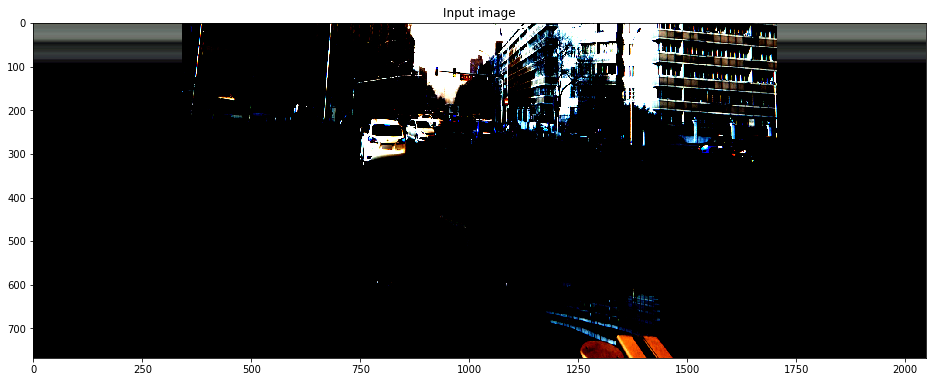

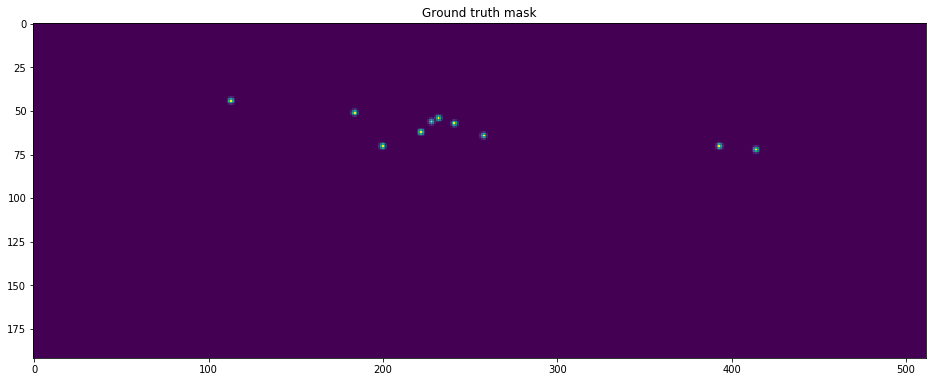

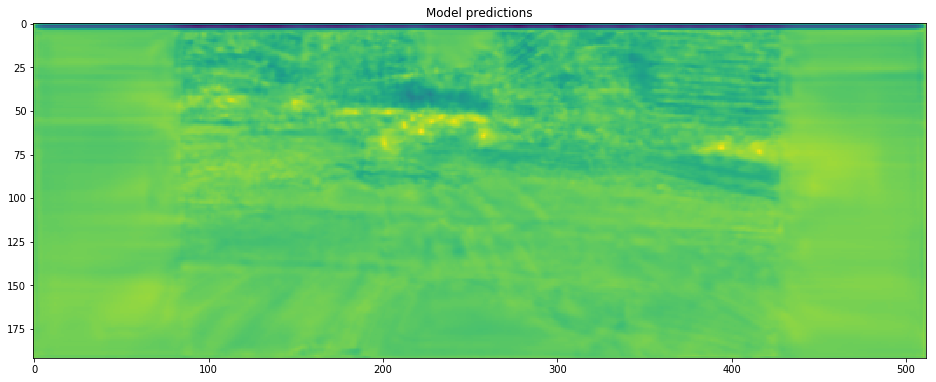

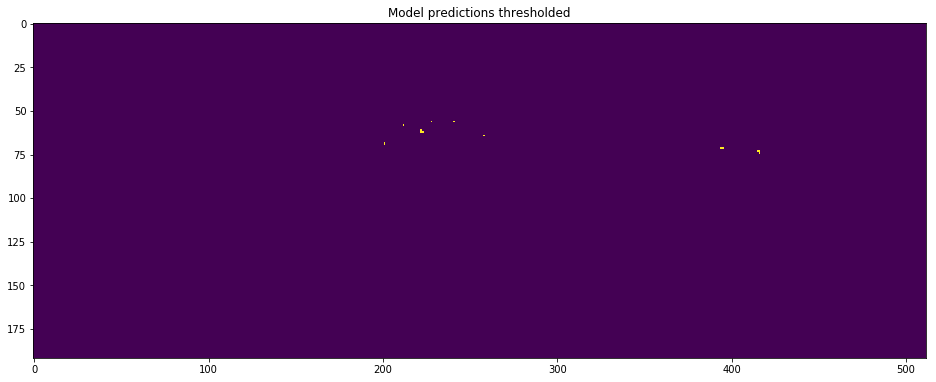

In [48]:
img, mask, regr, mask2 = dev_dataset[0]

plt.figure(figsize=(16,16))
plt.title('Input image')
plt.imshow(np.rollaxis(img, 0, 3))
plt.show()

plt.figure(figsize=(16,16))
plt.title('Ground truth mask')
plt.imshow(mask)
plt.show()
with torch.no_grad():
    output = model(torch.tensor(img[None]).to(device))
logits = output[0,0].data.cpu().numpy()

plt.figure(figsize=(16,16))
plt.title('Model predictions')
plt.imshow(logits)
plt.show()

plt.figure(figsize=(16,16))
plt.title('Model predictions thresholded')
plt.imshow(logits > 0)
plt.show()

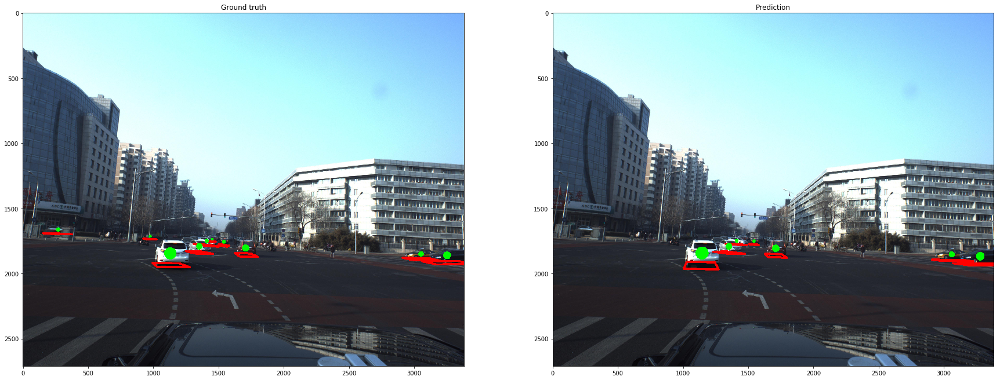

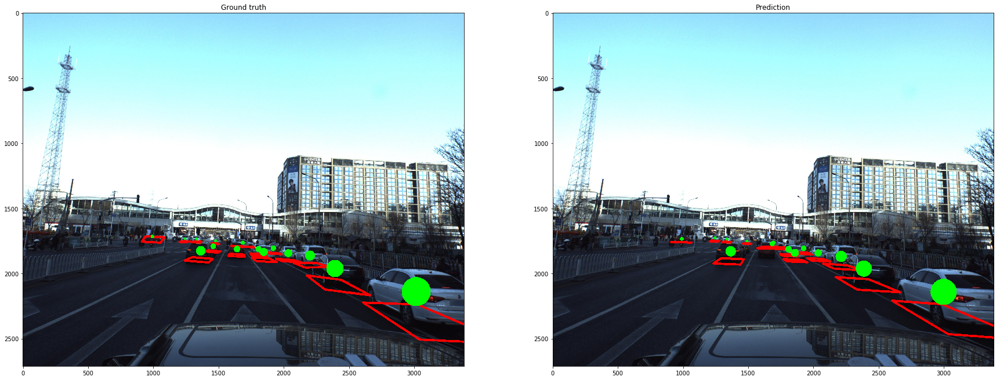

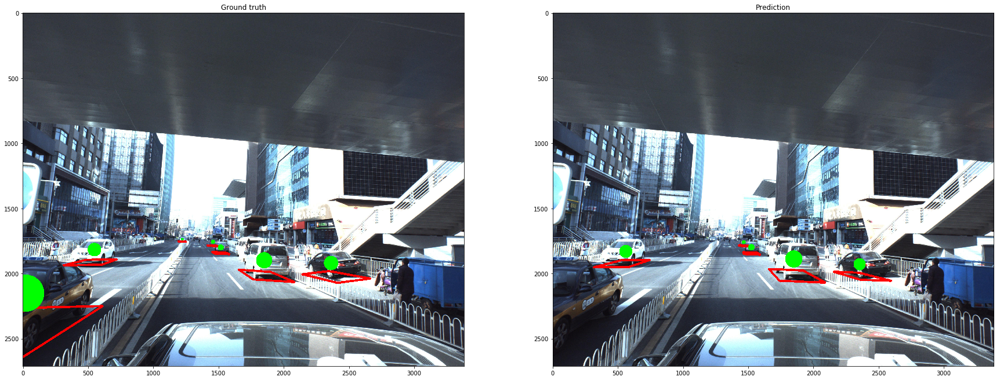

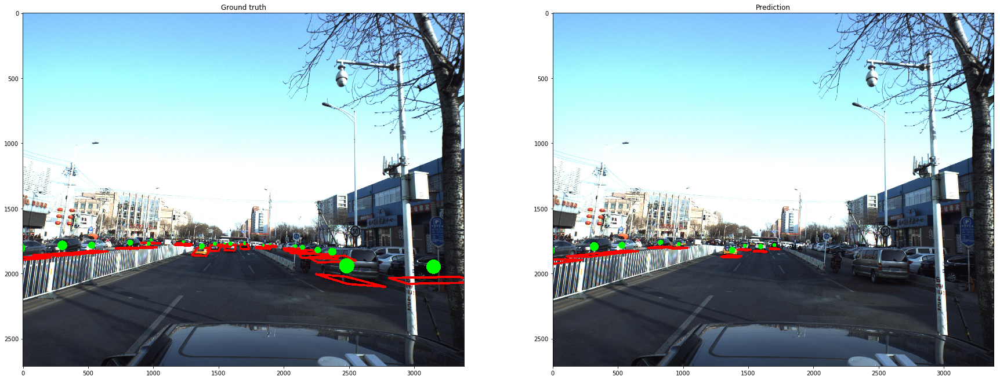

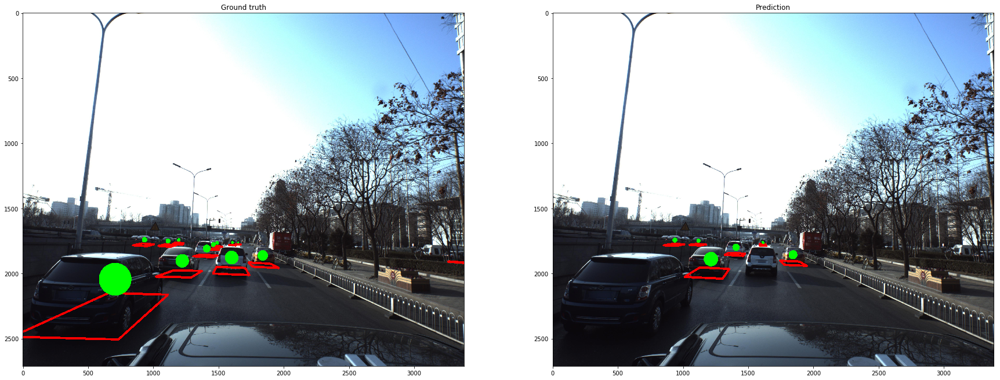

...

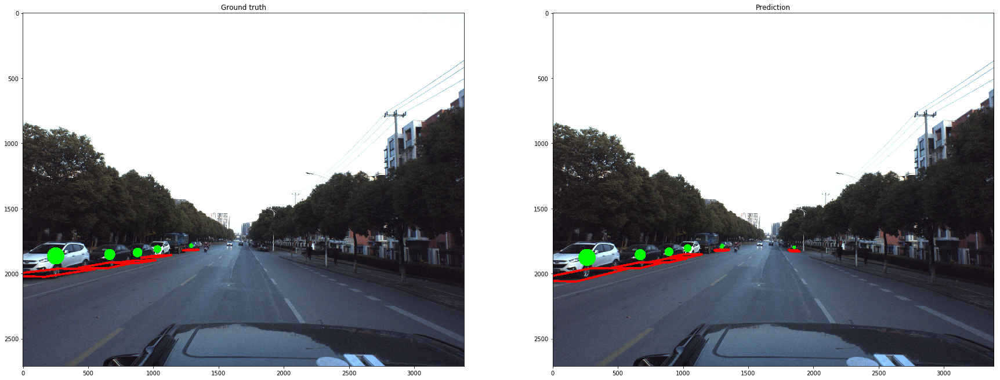

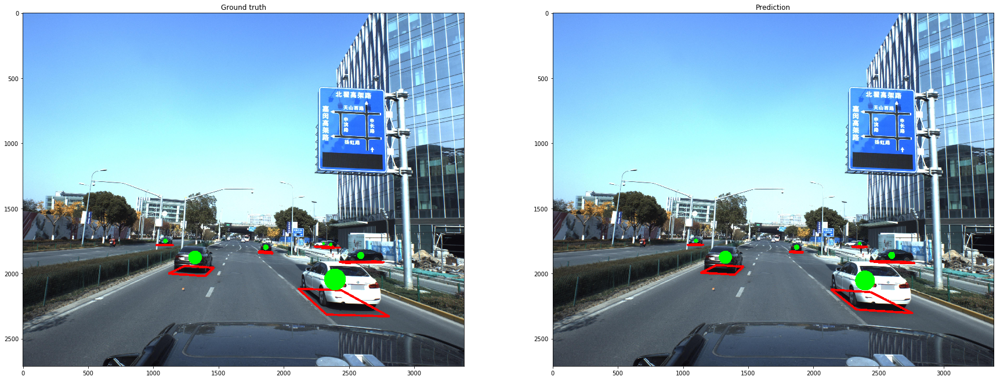

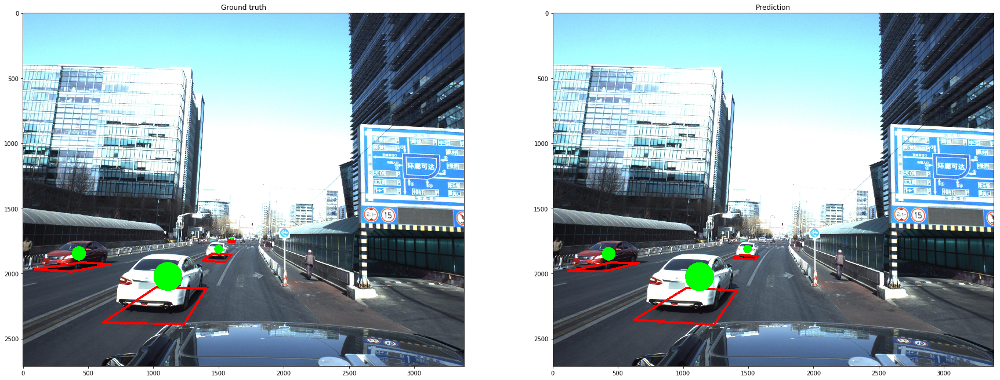

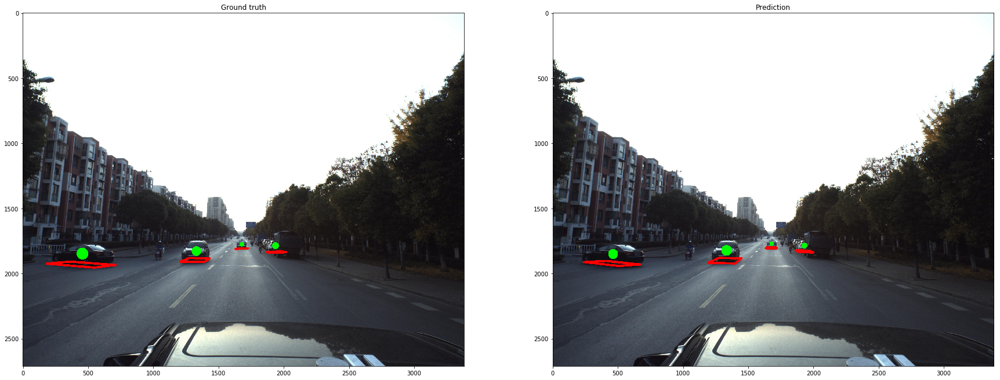

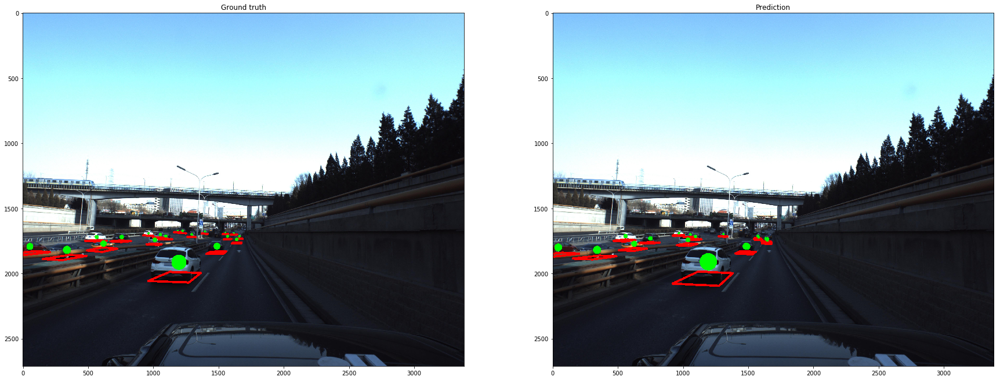

In [50]:
torch.cuda.empty_cache()
import gc
gc.collect()

#model2 = model
#model2.load_state_dict(torch.load('./resnext_focaloss_gauss_lr01_4{}.pth'.format(str(43))))

for idx in range(30):
    img, mask, regr, mask2 = dev_dataset[idx]
    with torch.no_grad():
        output = model(torch.tensor(img[None]).to(device)).data.cpu().numpy()
        #outputq = model2(torch.tensor(img[None]).to(device)).data.cpu().numpy()
        coords_pred = extract_coords((output[0]), 0.4)
        coords_true = extract_coords(np.concatenate([mask[None], regr], 0), 0.7)

        img = imread(train_images_dir.format(df_dev['ImageId'].iloc[idx]))

        fig, axes = plt.subplots(1, 2, figsize=(30,30))
        axes[0].set_title('Ground truth')
        axes[0].imshow(visualize(img, coords_true))
        axes[1].set_title('Prediction')
        axes[1].imshow(visualize(img, coords_pred))
        plt.show()

In [54]:
for thresh in [0.3,0.4]:
    evaluate_model(model, thresh)

/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  from ipykernel import kernelapp as app



dev loss: tensor(0.0018, device='cuda:0')
mask loss: 0.57692015
xyz loss: 0.5762223
ang loss: nan


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/urllib3/connectionpool.py:857: InsecureRequestWarning: Unverified HTTPS request is being made. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning)


Dev loss: 0.0018
map: 0.1975741251859127


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/urllib3/connectionpool.py:857: InsecureRequestWarning: Unverified HTTPS request is being made. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning)


map: 0.1458719715835718


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/urllib3/connectionpool.py:857: InsecureRequestWarning: Unverified HTTPS request is being made. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning)


eval failed


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/urllib3/connectionpool.py:857: InsecureRequestWarning: Unverified HTTPS request is being made. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning)
/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  from ipykernel import kernelapp as app



dev loss: tensor(0.0018, device='cuda:0')
mask loss: 0.57692015
xyz loss: 0.5762223
ang loss: nan


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/urllib3/connectionpool.py:857: InsecureRequestWarning: Unverified HTTPS request is being made. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning)


Dev loss: 0.0018
map: 0.18120488181136754
line failed
map: 0.14673858643143906


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/urllib3/connectionpool.py:857: InsecureRequestWarning: Unverified HTTPS request is being made. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning)


eval failed


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/urllib3/connectionpool.py:857: InsecureRequestWarning: Unverified HTTPS request is being made. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning)


# Make submission

In [55]:
predictions = []

test_loader = DataLoader(dataset=test_dataset, batch_size=4, shuffle=False, num_workers=4)

model.eval()

for img, _, _, ign_mask in tqdm(test_loader):
    with torch.no_grad():
        output = model(img.to(device))
    output = output.data.cpu().numpy()
    for out,ign in zip(output, ign_mask.cpu().numpy()):
        out[0] = pool(out[0]) - ign
        coords = extract_coords(out, 0.4)
        s = coords2str(coords)
        predictions.append(s)

/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/ipykernel_launcher.py:7: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  import sys


In [56]:
test = pd.read_csv(PATH + 'sample_submission.csv')
test['PredictionString'] = predictions
test.to_csv('predictions04.csv', index=False)
test.head()

,ImageId,PredictionString
0,ID_18fb86d04,
1,ID_ce06d4dc1,0.1483981 0.01736547992816578 -3.0987508205049...
2,ID_afe07078f,0.12947379 0.14266679168999125 -3.094898825632...
3,ID_37caf75aa,0.123396486 0.06313136274630737 -3.07796473254...
4,ID_7655363ca,0.13736024 -3.062854511024695 -3.1325727013223...


In [57]:
from IPython.display import FileLink
FileLink(r'predictions04.csv')

/home/ubuntu/kaggle-pku/predictions04.csv

In [ ]:
predictions = []

test_loader = DataLoader(dataset=test_dataset, batch_size=4, shuffle=False, num_workers=4)

model.eval()

for img, _, _, ign_mask in tqdm(test_loader):
    with torch.no_grad():
        output = model(img.to(device))
    output = output.data.cpu().numpy()
    for out,ign in zip(output, ign_mask.cpu().numpy()):
        out[0] = pool(out[0]) - ign
        coords = extract_coords(out, 0.3)
        s = coords2str(coords)
        predictions.append(s)

/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/ipykernel_launcher.py:7: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  import sys


In [ ]:
test = pd.read_csv(PATH + 'sample_submission.csv')
test['PredictionString'] = predictions
test.to_csv('predictions03.csv', index=False)
test.head()

In [ ]:
from IPython.display import FileLink
FileLink(r'predictions03.csv')